In [1]:
# Autoreload external modules https://ipython.org/ipython-doc/3/config/extensions/autoreload.html
%load_ext autoreload
%autoreload 2

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import cv2 as cv
import os
from functools import partial
import mpldatacursor
from path_provider import PathProvider
from ellipse_detector import EllipseDetector
from skimage.filters.rank import otsu
from skimage.filters import threshold_otsu

In [3]:
#check if openCV use Optimalization
cv.useOptimized()

True

In [4]:
def examine_imgs(procces_img_func, data, columns = 4, size = 10, show_title=True):
    """
    data - image/image_path depends on procces_img_func
    procces_img_func - funcion, that take exactly one argument -> image/image_path and return processed image
    """
    rows = len(data) / columns + 1
    figsize = (size*columns, size*rows)
    f = plt.figure(figsize=figsize)
    for i, image in enumerate(data):
        img = procces_img_func(image)
        sp = f.add_subplot(rows, columns, i+1)
        sp.axis('Off')
        if show_title:
            title_text = str(i)
            # if items in data are type of string
            if isinstance(image, str):
                title_text += image
            sp.set_title(title_text, fontsize=18)
        plt.imshow(img)
    plt.show() 
    
    
def grey2RGB(image):
    return cv.cvtColor(image,cv.COLOR_GRAY2RGB)

def identity(image):
    return image

def image_equalization_to8bit(image):
    return (cv.normalize(image, dst=None, alpha=0, beta=65535, norm_type=cv.NORM_MINMAX)/256).astype('uint8')

def get_img_stats(img):
    return "shape={}, (min, max)= ({},{}) ".format(img.shape, np.min(img), np.max(img))

### Get paths to images

In [5]:
pathprovide = PathProvider()
img_paths_dict = pathprovide.get_paths_dict()

### Plot images
args:  
`CATEGORY` - specify which categery you wanna plot  
`NUM_TO_PLOT` - how many imgs do you wanna plot

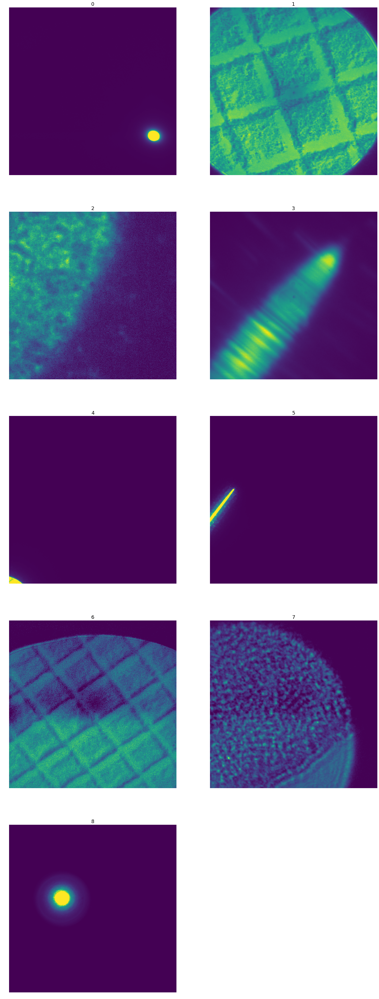

In [6]:
NUM_TO_PLOT = 100
CATEGORY = 2
raw_imgs = []
img_paths_to_plot = img_paths_dict[CATEGORY]
for img_path in img_paths_to_plot[:NUM_TO_PLOT]:
    raw_imgs.append(cv.imread((img_path), cv.IMREAD_ANYDEPTH))

examine_imgs(identity, raw_imgs, 2, 12)

### Plot raw, ground truth and histogram of raw and normalized raw img

In [7]:
# NUM_TO_PLOT = 100
# CATEGORY = 4
# columns = 3
# size_of_img = 12

def plot_histograms(img_paths_dict, category, NUM_TO_PLOT=100, columns=3, size_of_img = 12):
    
    raw_imgs = []
    img_analysis = []
    img_paths_to_plot = img_paths_dict[category]
    for img_path in img_paths_to_plot[:NUM_TO_PLOT]:
        # equalized image
        raw = cv.imread((img_path), cv.IMREAD_ANYDEPTH)
        raw_imgs.append(raw)
        raw_normalized = image_equalization_to8bit(raw)
        img_analysis.append(cv.cvtColor(raw_normalized, cv.COLOR_GRAY2RGB))

        # ground truth 
        ground_truth_path = pathprovide.get_ground_truth_path(img_path)
        ground_truth_img = cv.imread((ground_truth_path))
        img_analysis.append(cv.cvtColor(ground_truth_img,cv.COLOR_BGR2RGB))

    # plot it
    rows = len(img_paths_to_plot[:NUM_TO_PLOT])*3 / columns + 1
    figsize = (size_of_img*columns, size_of_img*rows)
    f = plt.figure(figsize=figsize)

    for i, img_path in enumerate(img_paths_to_plot[:NUM_TO_PLOT]):

        # equalized image
        sp = f.add_subplot(rows, columns, i*3+1)
        title_text = "{}, {}".format(i, os.path.basename(img_path))
        sp.set_title(title_text, fontsize=18)
        sp.axis('Off')
        plt.imshow(img_analysis[i*2])

        # ground truth
        ground_truth = img_analysis[i*2+1]
        sp = f.add_subplot(rows, columns, i*3+2)
        sp.axis('Off')
        plt.imshow(ground_truth)

        # histrogram of raw image and normalized 
        raw = cv.imread((img_path), cv.IMREAD_ANYDEPTH)
        normalized = cv.normalize(raw, dst=None, alpha=0, beta=65535, norm_type=cv.NORM_MINMAX)

        raw_max = int(np.max(raw))
        normalized_max = int(np.max(normalized))

        sp = f.add_subplot(rows, columns, i*3+3)
        histr = cv.calcHist([normalized],[0],None,[normalized_max],[-100,normalized_max+100])
        sp.set_title("(max raw, max normalized) = ({}, {})".format(raw_max, normalized_max), fontsize=18)
        plt.plot(histr, color = "blue")
        histr = cv.calcHist([raw],[0],None,[raw_max],[-100,raw_max+100])
        plt.plot(histr, color = "red")
        plt.yscale('log')
        plt.xlim([0,normalized_max])

    plt.show() 
    return raw_imgs

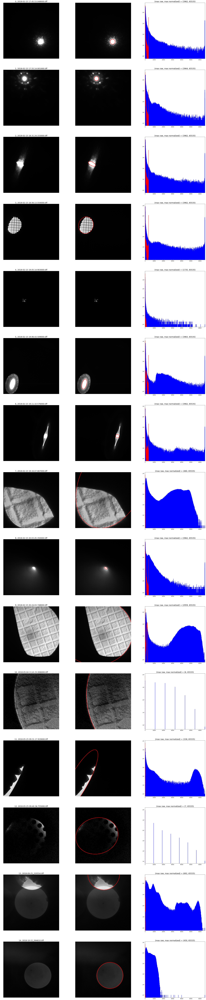

In [8]:
raw_imgs = plot_histograms(img_paths_dict, 6)

### Plot histogram of One img

shape: (982, 982), (min, max) = (0, 3962)
(max raw, max normalized) = (3962, 65535)


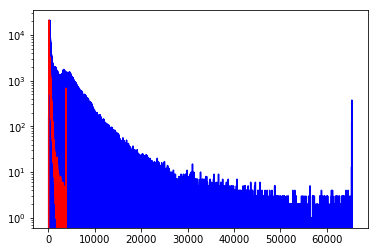

In [9]:
test_img = raw_imgs[8]
test_img2 = cv.normalize(test_img, dst=None, alpha=0, beta=65535, norm_type=cv.NORM_MINMAX)
print("shape: {}, (min, max) = ({}, {})".format(test_img.shape, np.amin(test_img), np.amax(test_img)))
# hist = cv.calcHist([test_img],[0],None,[256],[0,256])
# plt.hist(test_img.ravel(),100,[np.min(test_img),np.max(test_img)]); plt.show()

img1_max = int(np.max(test_img))
img2_max = int(np.max(test_img2))
print("(max raw, max normalized) = ({}, {})".format(img1_max, img2_max))
histr = cv.calcHist([test_img2],[0],None,[img2_max],[-100,img2_max+100])
plt.plot(histr, color = "blue")
histr = cv.calcHist([test_img],[0],None,[img1_max],[-100,img1_max+100])
plt.plot(histr, color = "red")
plt.yscale('log')

plt.show()

### 16 bit -> 8bit + histogram equalization

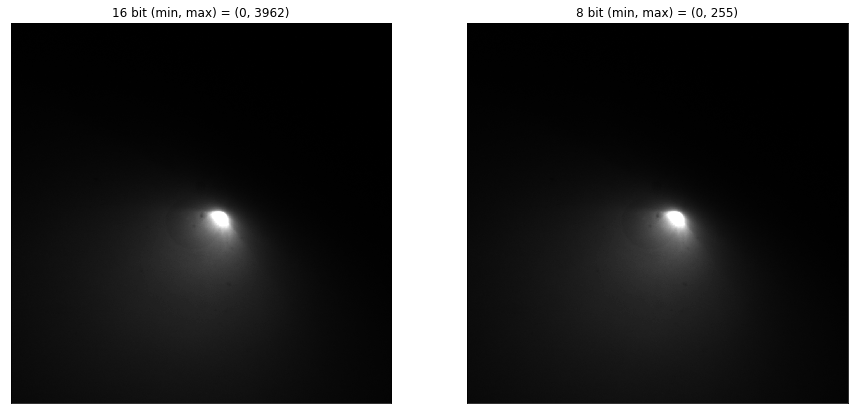

In [10]:
img = raw_imgs[8]
# img8 = (img/256).astype('uint8')
# img8 = cv.normalize(img, dst=None, alpha=0, beta=65535, norm_type=cv.NORM_MINMAX)
img8 = image_equalization_to8bit(img)

fig = plt.figure(figsize=(15, 15))
fig.add_subplot(1,2,1)
plt.imshow(img,'gray')
plt.title('16 bit (min, max) = ({}, {})'.format(np.min(img), np.max(img)))
plt.xticks([]),plt.yticks([])
           
fig.add_subplot(1,2,2)
plt.imshow(img8,'gray')
plt.title('8 bit (min, max) = ({}, {})'.format(np.min(img8), np.max(img8)))
plt.xticks([]),plt.yticks([])

plt.show()

### Choose one image by its ID and plot it

shape: (982, 982), (min, max) = (0, 255)


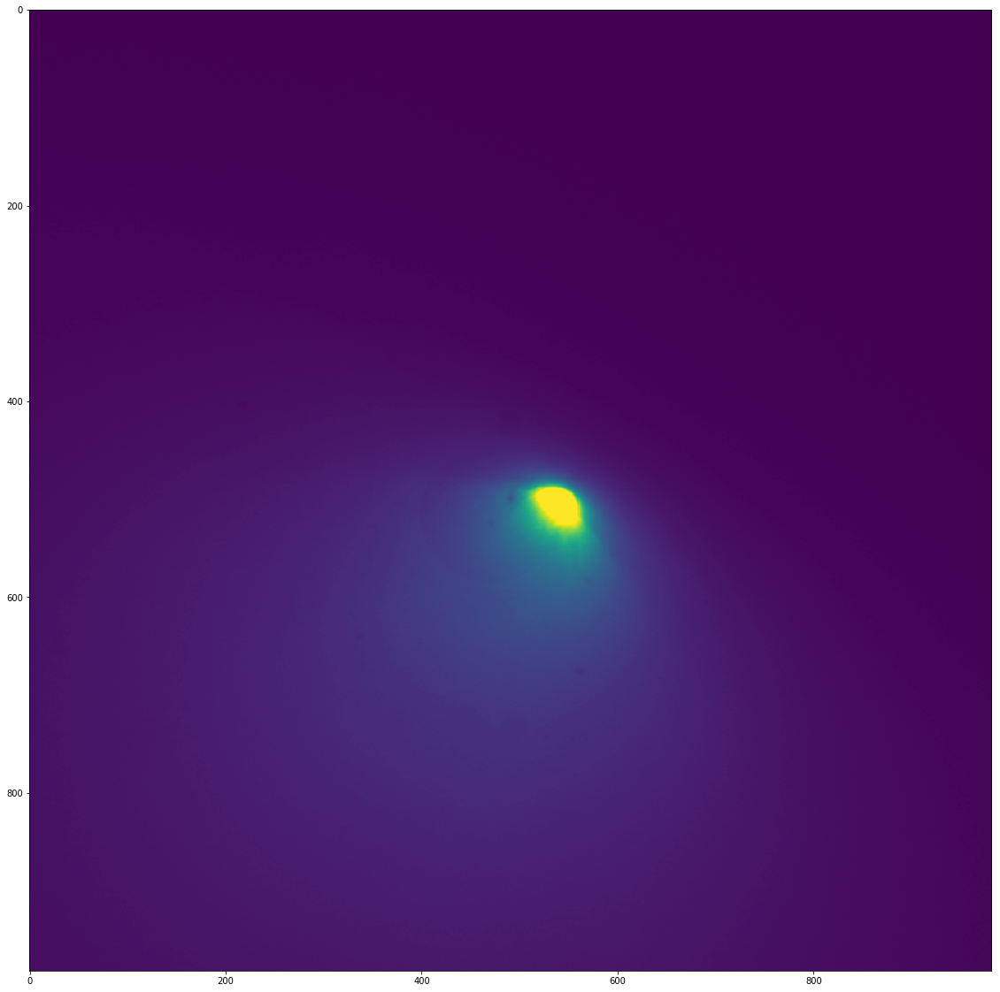

In [11]:
index = 8
img = image_equalization_to8bit(raw_imgs[index])
print("shape: {}, (min, max) = ({}, {})".format(img.shape, np.amin(img), np.amax(img)))
fig, ax = plt.subplots(figsize=(20,20))
# plt.imshow(img, cmap = 'gray', interpolation = 'bicubic')
# plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
# plt.show()
plt.imshow(img)
plt.show()

# Try some image processing methods

In [12]:
# use median blur filter
# blur_img = cv.medianBlur(img,5)
blur_img = cv.GaussianBlur(img,(5,5),0)

### try two ways of visualization, result is same

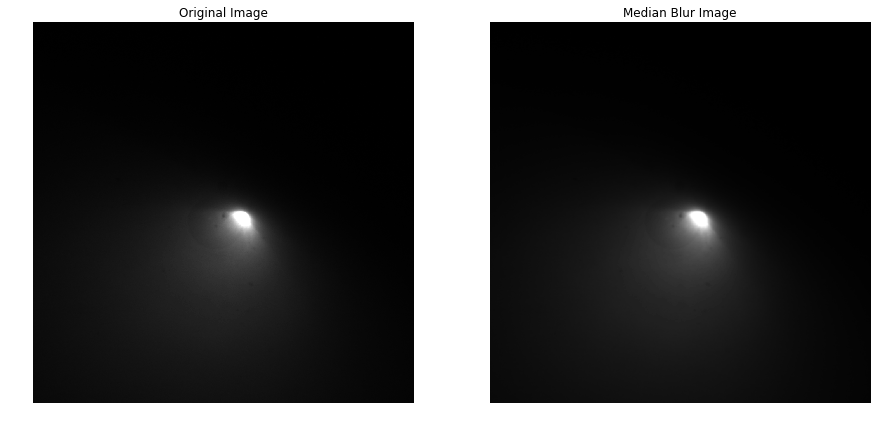

In [13]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(15,30))
ax1.imshow(img,'gray')
ax1.set_title('Original Image')
ax1.axis('off') 

ax2.imshow(blur_img,'gray')
ax2.set_title('Median Blur Image')
ax2.axis('off') 

plt.show()

### Try some thresholds
https://docs.opencv.org/4.0.0/d7/d4d/tutorial_py_thresholding.html

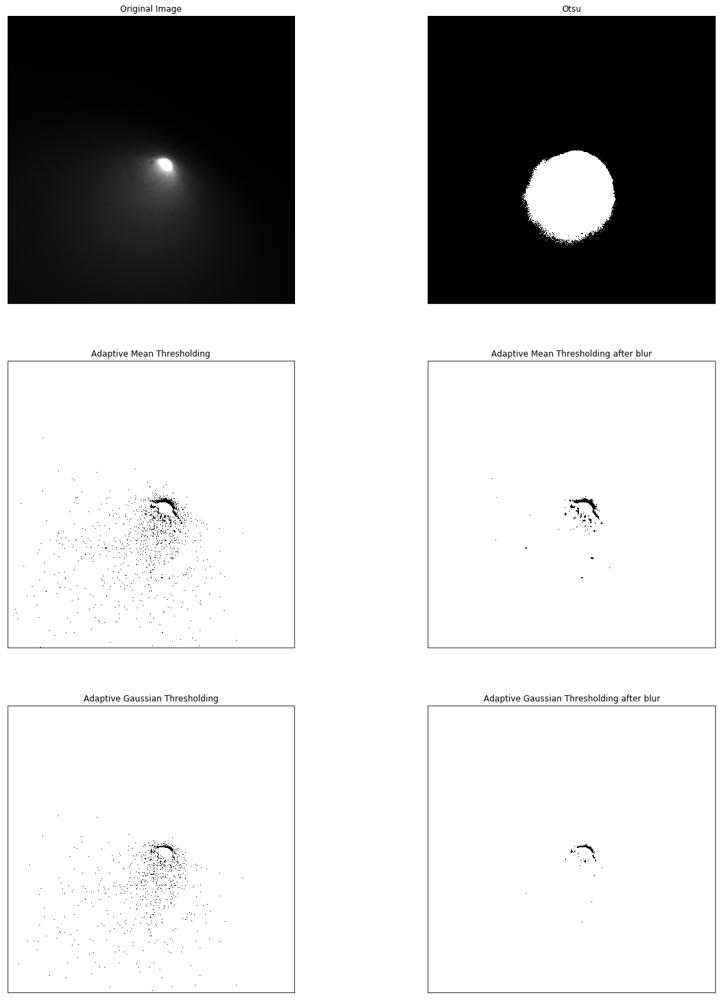

In [14]:
blockSize = 11
c = 2
# ret,th1 = cv.threshold(blur_img,127,255,cv.THRESH_BINARY)
_, th1 = cv.threshold(img, 0, 255, cv.THRESH_BINARY+cv.THRESH_OTSU)
th2 = cv.adaptiveThreshold(img,255,cv.ADAPTIVE_THRESH_MEAN_C,\
            cv.THRESH_BINARY,blockSize,c)
th3 = cv.adaptiveThreshold(blur_img,255,cv.ADAPTIVE_THRESH_MEAN_C,\
            cv.THRESH_BINARY,blockSize,c)
th4 = cv.adaptiveThreshold(img,255,cv.ADAPTIVE_THRESH_GAUSSIAN_C,\
            cv.THRESH_BINARY,blockSize,c)
th5 = cv.adaptiveThreshold(blur_img,255,cv.ADAPTIVE_THRESH_GAUSSIAN_C,\
            cv.THRESH_BINARY,blockSize,c)

titles = ['Original Image', 'Otsu',
            'Adaptive Mean Thresholding', 'Adaptive Mean Thresholding after blur', 
          'Adaptive Gaussian Thresholding', 'Adaptive Gaussian Thresholding after blur']
images = [img, th1, th2, th3, th4, th5]

fig = plt.figure(figsize=(20, 26))

for i in range(len(images)):
    sp = fig.add_subplot(3,2,i+1)
    plt.imshow(images[i],'gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
plt.show()

### Try some morphological transformations
https://docs.opencv.org/4.0.0/d9/d61/tutorial_py_morphological_ops.html

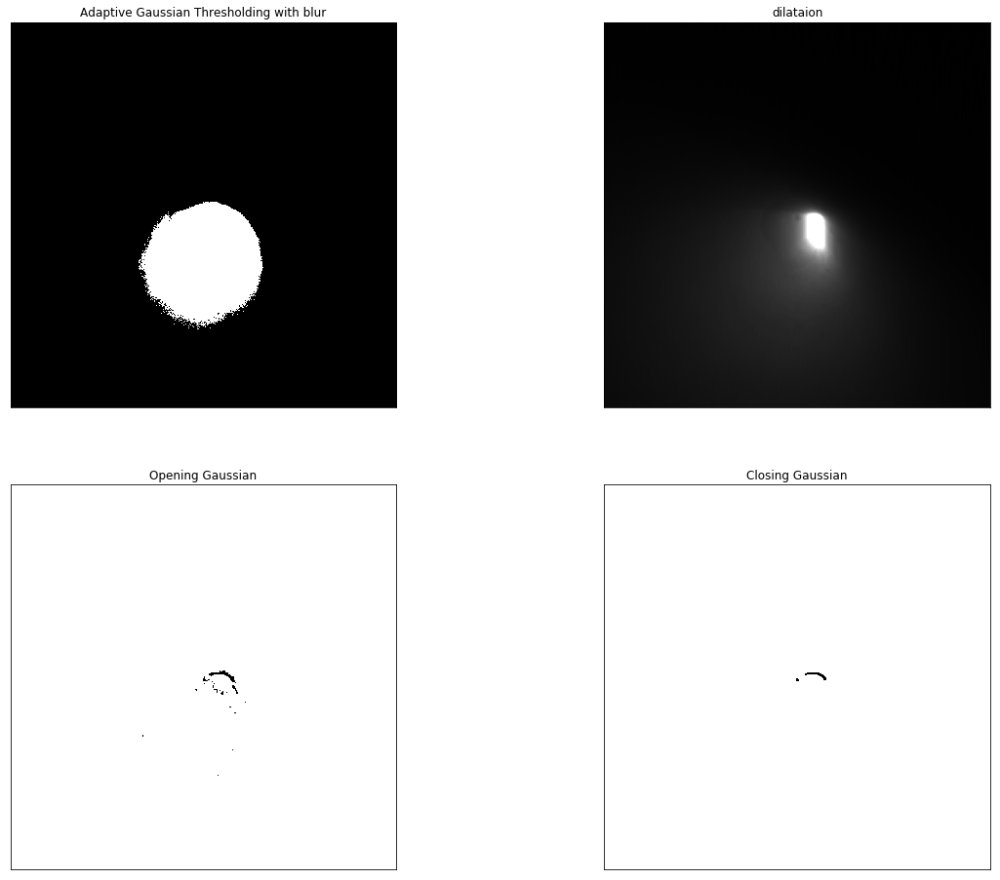

In [15]:
kernel = np.ones((5,5),np.uint8)
# closing_m = cv.morphologyEx(th3, cv.MORPH_CLOSE, kernel)
dilation = cv.dilate(img,(3,3),iterations = 50)
opening_g = cv.morphologyEx(th5, cv.MORPH_OPEN, kernel)
closing_g = cv.morphologyEx(th5, cv.MORPH_CLOSE, kernel)

titles = ['Adaptive Gaussian Thresholding with blur', 'dilataion',
            'Opening Gaussian', 'Closing Gaussian']
images = [th1, dilation, opening_g, closing_g]

fig = plt.figure(figsize=(20, 16))

for i in range(4):
    sp = fig.add_subplot(2,2,i+1)
    plt.imshow(images[i],'gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
plt.show()

### Try image gradient method
https://docs.opencv.org/4.0.0/d5/d0f/tutorial_py_gradients.html

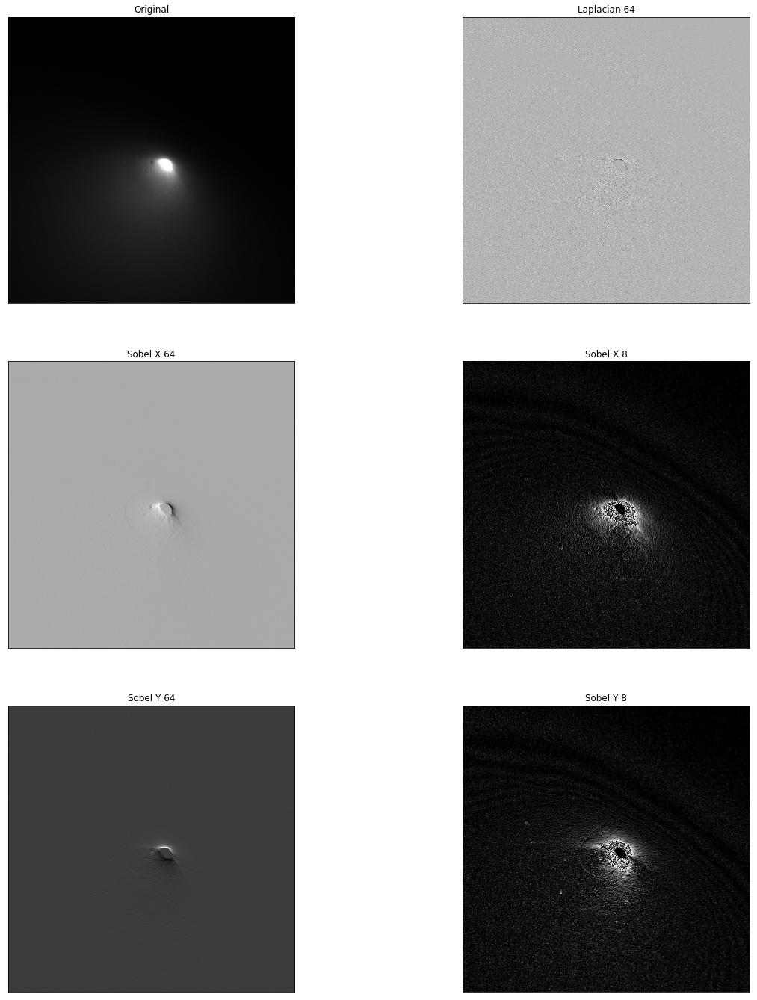

In [16]:
laplacian64f = cv.Laplacian(img,cv.CV_64F)
sobelx64f = cv.Sobel(img,cv.CV_64F,1,0,ksize=5)
sobely64f = cv.Sobel(img,cv.CV_64F,0,1,ksize=5)

abs_sobelx64f= np.absolute(sobelx64f)
sobelx_8u = np.uint8(abs_sobelx64f)
abs_sobely64f= np.absolute(sobely64f)
sobely_8u = np.uint8(abs_sobely64f)

titles = ['Original', 'Laplacian 64',
            'Sobel X 64', 'Sobel X 8',
          'Sobel Y 64', 'Sobel Y 8']
images = [img, laplacian64f, sobelx64f, sobelx_8u, sobely64f, sobely_8u]

fig = plt.figure(figsize=(20, 24))

for i in range(6):
    sp = fig.add_subplot(3,2,i+1)
    plt.imshow(images[i],'gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
plt.show()

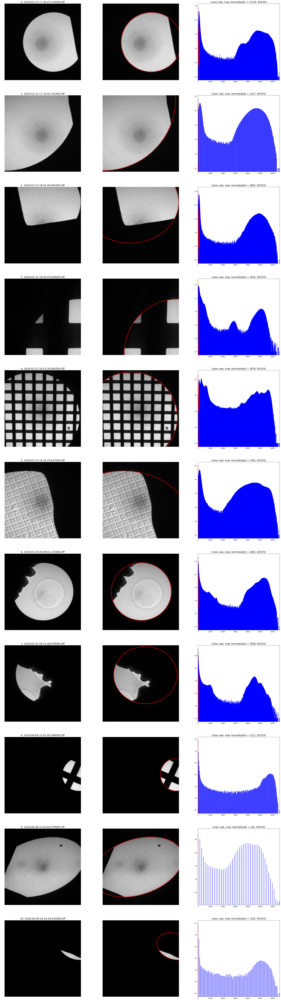

In [162]:
raw_imgs = plot_histograms(img_paths_dict, 3)

### Plot ground truth, img used for is_beam_in_img() + hist

In [218]:
# NUM_TO_PLOT = 100
# CATEGORY = 4
# columns = 3
# size_of_img = 12

def plot_histograms2(img_paths_dict, category, NUM_TO_PLOT=100, columns=3, size_of_img = 12):
    
    raw_imgs = []
    img_analysis = []
    img_paths_to_plot = img_paths_dict[category]
    for img_path in img_paths_to_plot[:NUM_TO_PLOT]:
        # ground truth 
        ground_truth_path = pathprovide.get_ground_truth_path(img_path)
        ground_truth_img = cv.imread((ground_truth_path))
        img_analysis.append(cv.cvtColor(ground_truth_img,cv.COLOR_BGR2RGB))

        raw = cv.imread((img_path), cv.IMREAD_ANYDEPTH)
        raw_normalized = image_equalization_to8bit(raw)
        beam_in_image, img_for_beam_detection = is_beam_in_img(raw)
        input_to_ellipse_matcher = processing_func(raw_normalized)
#         img_analysis.append(cv.cvtColor(img_for_beam_detection, cv.COLOR_GRAY2RGB))
        img_analysis.append(img_for_beam_detection)

    
    # plot it
    rows = len(img_paths_to_plot[:NUM_TO_PLOT])*3 / columns + 1
    figsize = (size_of_img*columns, size_of_img*rows)
    f = plt.figure(figsize=figsize)

    for i, img_path in enumerate(img_paths_to_plot[:NUM_TO_PLOT]):

        # equalized image
        sp = f.add_subplot(rows, columns, i*3+1)
        title_text = "{}, {}".format(i, os.path.basename(img_path))
        sp.set_title(title_text, fontsize=18)
        sp.axis('Off')
        plt.imshow(img_analysis[i*2])

        # equalized image
        equalized = img_analysis[i*2+1]
        sp = f.add_subplot(rows, columns, i*3+2)
        sp.axis('Off')
        plt.imshow(cv.cvtColor(equalized, cv.COLOR_GRAY2RGB))

        # histrogram of raw image and equalized image
        raw = cv.imread((img_path), cv.IMREAD_ANYDEPTH)
        normalized = image_equalization_to8bit(raw)
        
        if (np.max(normalized) != 255):
            normalized += 1
        if (np.max(equalized) != 255):
            equalized += 1
        normalized_max = int(np.max(normalized))
        equalized_max = int(np.max(equalized))
        
#         print("normalized_max: {}, equalized_max: {}".format(normalized_max, equalized_max))
        sp = f.add_subplot(rows, columns, i*3+3)
        histr = cv.calcHist([equalized],[0],None,[equalized_max],[-100,equalized_max+100])
        sp.set_title("(max normalized, max equalized_max) = ({}, {})".format(normalized_max, equalized_max), fontsize=18)
        sp.plot(histr, color = "blue")
        histr = cv.calcHist([normalized],[0],None,[normalized_max],[-100,normalized_max+100])
        sp.plot(histr, color = "red")
        plt.yscale('log')

    plt.show() 

In [219]:
ellipse_detector = EllipseDetector()

In [220]:
def processing_f1(img):
    # blur_img = cv.medianBlur(img,5)
    blur_img = cv.GaussianBlur(img,(5,5),0)
    _, th = cv.threshold(blur_img, 0, 255, cv.THRESH_BINARY+cv.THRESH_OTSU)
    kernel = np.ones((5,5),np.uint8)
    dilation = cv.dilate(th,kernel,iterations = 12)
    erosion = cv.erode(dilation,kernel,iterations = 12)
    return erosion

In [221]:
def is_beam_in_img(img):
    beam_included = True
    
    normalized = image_equalization_to8bit(img)
    
    img = cv.GaussianBlur(normalized,(5,5),0)
    img = cv.erode(img,(5,5),iterations = 40)
    img = cv.GaussianBlur(img,(9,9),0)
    img = cv.erode(img,(5,5),iterations = 40)
    img = cv.GaussianBlur(img,(9,9),0)
    kernel = np.ones((19,19),np.float32)/361
    for i in range(10):
        img = cv.filter2D(img,-1,kernel)
    img = cv.erode(img,(5,5),iterations = 40)
    img = cv.GaussianBlur(img,(9,9),0)

    normalized_avg = np.average(normalized)
    normalized_min = int(np.min(normalized))
    normalized_max = int(np.max(normalized))
    processed_avg = np.average(img)
    processed_min = int(np.min(img))
    processed_max = int(np.max(img))
    print("avg -> raw: {}, processed: {}".format(normalized_avg, processed_avg))
    print("min, max -> raw: ({},{}), processed: ({},{})".format(normalized_min, normalized_max, processed_min, processed_max))
    try:
        div_avg = normalized_avg/processed_avg
    except:
        div_avg = 10
    if ((processed_max - processed_min) < 45) and (div_avg > 1.6):
        beam_included = False
    
    # Doesnt work return True, everytime 
    beam_included = True
    return beam_included, img

avg -> raw: 11.601606928791568, processed: 5.738153359244404
min, max -> raw: (0,255), processed: (0,59)
avg -> raw: 22.32879613076103, processed: 15.966851390196656
min, max -> raw: (0,255), processed: (3,87)
avg -> raw: 52.989424716174234, processed: 40.65504747367068
min, max -> raw: (0,255), processed: (4,146)
avg -> raw: 45.525221813415406, processed: 44.09549072718298
min, max -> raw: (0,255), processed: (13,168)
avg -> raw: 9.594681870408701, processed: 6.931007628141579
min, max -> raw: (0,255), processed: (0,149)
avg -> raw: 8.143113725262463, processed: 5.051505510596024
min, max -> raw: (0,255), processed: (1,28)
avg -> raw: 18.62440217188414, processed: 16.83930400985561
min, max -> raw: (0,255), processed: (2,74)
avg -> raw: 14.92416138144441, processed: 11.18676191819347
min, max -> raw: (0,255), processed: (0,117)
avg -> raw: 34.62040147569444, processed: 30.019405381944445
min, max -> raw: (0,255), processed: (6,76)


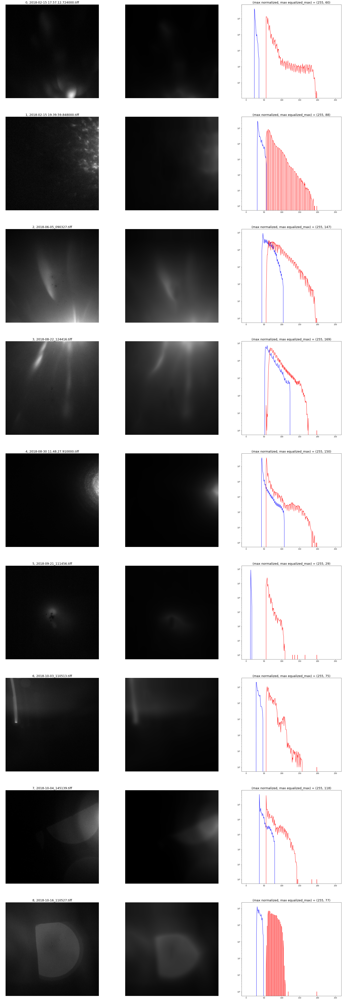

In [217]:
plot_histograms2(img_paths_dict, 5)

avg -> raw: 86.22106159340636, processed: 63.744145121349256
min, max -> raw: (0,255), processed: (1,212)
avg -> raw: 132.49105798466076, processed: 118.37783255420378
min, max -> raw: (0,255), processed: (2,197)
avg -> raw: 68.71067919081139, processed: 60.31303275662537
min, max -> raw: (0,255), processed: (1,195)
avg -> raw: 21.0543541382357, processed: 8.755760512027077
min, max -> raw: (0,255), processed: (0,196)
avg -> raw: 85.5611060183092, processed: 15.889454166856783
min, max -> raw: (0,255), processed: (1,40)
avg -> raw: 96.34816202852983, processed: 62.758129010581506
min, max -> raw: (0,255), processed: (1,156)
avg -> raw: 82.14138454861111, processed: 60.741885850694445
min, max -> raw: (0,255), processed: (0,215)
avg -> raw: 22.876089409722223, processed: 12.836455078125
min, max -> raw: (0,255), processed: (0,179)
avg -> raw: 8.017564019097222, processed: 0.6738671875
min, max -> raw: (0,255), processed: (0,147)
avg -> raw: 98.37572265625, processed: 71.84401475694445
m

C:\Users\lukas\Anaconda3\envs\image_processing\lib\site-packages\ipykernel_launcher.py:26: RuntimeWarning: divide by zero encountered in double_scalars


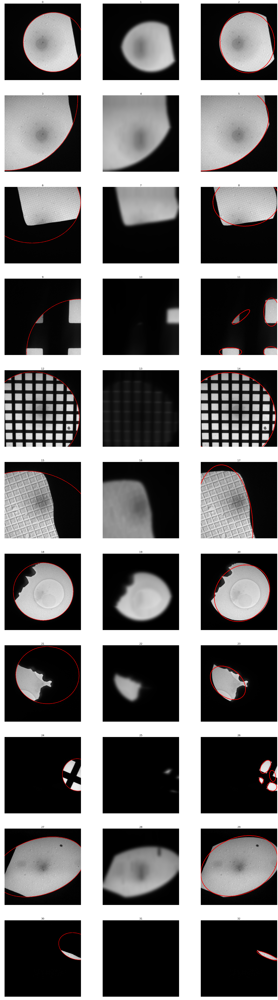

In [223]:
# preprocessing_f1 function with exacly one parametr: input image and return processed image 
processing_func = processing_f1

NUM_TO_PLOT = 100
CATEGORY = 3
columns = 3
size_of_img = 12

img_analysis = []
img_paths_to_plot = img_paths_dict[CATEGORY]
for img_path in img_paths_to_plot[:NUM_TO_PLOT]:   
    # ground truth 
    ground_truth_path = pathprovide.get_ground_truth_path(img_path)
    ground_truth_img = cv.imread((ground_truth_path))
    img_analysis.append(cv.cvtColor(ground_truth_img,cv.COLOR_BGR2RGB))

    # equalized image
    raw = cv.imread((img_path), cv.IMREAD_ANYDEPTH)
    raw_normalized = image_equalization_to8bit(raw)
    beam_in_image, img_for_beam_detection = is_beam_in_img(raw)
    input_to_ellipse_matcher = processing_func(raw_normalized)
    img_analysis.append(cv.cvtColor(img_for_beam_detection, cv.COLOR_GRAY2RGB))

    
    # raw with ellipses
    ellipses = ellipse_detector.detect_all_ellipses(input_to_ellipse_matcher)
    img_rgb = cv.cvtColor(raw_normalized, cv.COLOR_GRAY2RGB)
    img_with_ellipse = img_rgb.copy()

    # set color based it if is_beam_in_img method
    if not beam_in_image:
        color = (0, 255, 0)
    else:
        color = (255, 0, 0)
    for el in ellipses:
        img_with_ellipse = cv.ellipse(img_with_ellipse, el, color, thickness=5)
    img_analysis.append(img_with_ellipse)


examine_imgs(identity, img_analysis, 3, 12)